In [1]:
import os
os.chdir('../../Trade networks paper/Nature Communications submission/Revision/')

In [2]:
import os
import pandas as pd
import numpy as np
import geopandas as gpd
import networkx as nx
import ast
import json

import matplotlib.pyplot as plt
from matplotlib.lines import Line2D   
from mpl_toolkits.basemap import Basemap as Basemap
import matplotlib.ticker as tkr
import matplotlib.gridspec as gridspec
import seaborn as sns
import textwrap
from shapely import wkt
from shapely.geometry import shape

pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
os.environ["PROJ_LIB"] = "/opt/conda/share/proj"
sns.set()
%config InlineBackend.figure_format = 'retina'

### Figures and Tables

In [4]:
national_bilateral_flows_fig1a = pd.read_csv('data/national_bilateral_flows_fig1a.csv')
subnational_bilateral_flows_fig1b_1c = pd.read_csv('data/subnational_bilateral_flows_fig1b_1c.csv')
national_IDs = gpd.read_file('data/national_IDs.gpkg')
subnational_IDs = gpd.read_file('data/subnational_IDs.gpkg')

fig2_national_flows = pd.read_csv('data/fig2_national_flows.csv')
fig2_subnational_domestic_flows = pd.read_csv('data/fig2_subnational_domestic_flows.csv')
fig2_subnational_international_flows = pd.read_csv('data/fig2_subnational_international_flows.csv')

fig3a = pd.read_csv('data/fig3a.csv')
fig3b = pd.read_csv('data/fig3b.csv')
fig3c = pd.read_csv('data/fig3c.csv')
fig3d = pd.read_csv('data/fig3d.csv')

fig4 = pd.read_csv('data/fig4.csv')

fig5 = pd.read_csv('data/fig5.csv')

dict = {'Asia' : 'tab:red', 'Africa' : 'tab:cyan', 'Europe' : 'tab:purple', 
        'Latin America and the Caribbean' : 'tab:orange', 'Oceania': 'tab:blue', 
        'Northern America': 'tab:green'}

national_IDs = national_IDs.merge(subnational_IDs[['iso3', 'country']].drop_duplicates(), how='left')

#### Figure 1

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


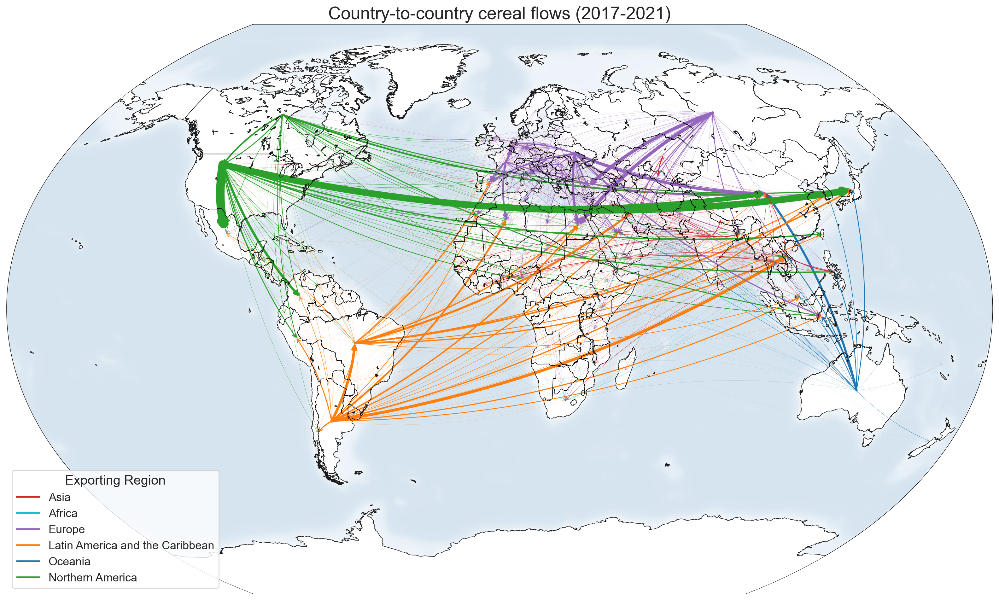

In [4]:
# Figure 1a: Cereal flows at national scales. Annual flows are presented, averaged over 2017-2021

df = national_bilateral_flows_fig1a[national_bilateral_flows_fig1a['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 2e6
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

graph = nx.from_pandas_edgelist(df, source='from_iso3', target='to_iso3',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='kav7',
            lat_0=0., # Center around
            lon_0=0., # lat 0, lon 0
            # suppress_ticks=True,
           ) 

# country positions
mx, my = m(national_IDs['longitude'].values, national_IDs['latitude'].values)
pos = {}
for count, elem in enumerate (national_IDs['iso3']):
    pos[elem] = (mx[count], my[count])

fig = plt.figure(figsize = (16,20))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=0.6)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=0.6, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )
m.shadedrelief(scale=0.1, alpha=0.3)

title = plt.title('Country-to-country cereal flows (2017-2021)', 
                  fontsize=20)

# h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors), connectionstyle="arc3,rad=0.1",
#                            node_shape='', node_size=0, alpha=1, arrows=True, arrowstyle='-')

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=10, arrowstyle='->')

def make_proxy(color, mappable, **kwargs):
    return Line2D([0, 1], [0, 1], color=color, **kwargs)

# generate proxies with the above function
proxies = [make_proxy(color, h, lw=2) for color in list(dict.values())]
labels = [list(dict.keys())[list(dict.values()).index(color)] for color in list(dict.values())]
plt.legend(proxies, labels, title="Exporting Region", fontsize=13, title_fontsize=15, facecolor="white", loc=3)

plt.tight_layout()
plt.show()

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


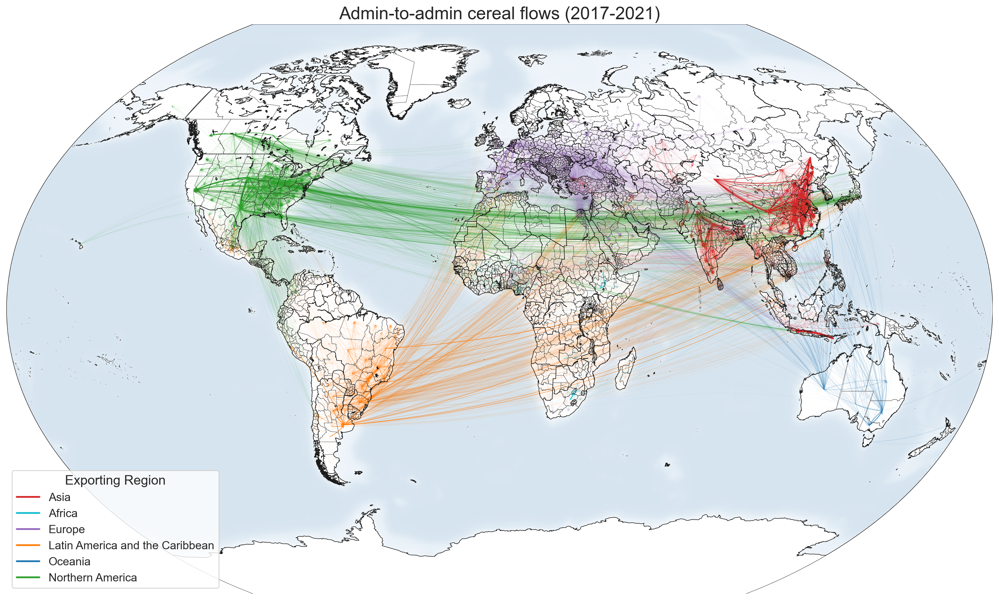

In [6]:
# Figure 1b: Top 5% of cereal flows at subnational scales. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 2e6
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

graph = nx.from_pandas_edgelist(df, source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='kav7',
            lat_0=0., # Center around
            lon_0=0., # lat 0, lon 0
            ) 

# admin positions
mx, my = m(subnational_IDs['longitude'].values, subnational_IDs['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs['ID']):
    pos[elem] = (mx[count], my[count])


plt.figure(figsize = (16,20))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=0.6)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=0.6, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )
m.shadedrelief(scale=0.1, alpha=0.3)

title = plt.title('Admin-to-admin cereal flows (2017-2021)', 
                  fontsize=20)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=7, arrowstyle='->')

def make_proxy(color, mappable, **kwargs):
    return Line2D([0, 1], [0, 1], color=color, **kwargs)

# generate proxies with the above function
proxies = [make_proxy(color, h, lw=2) for color in list(dict.values())]
labels = [list(dict.keys())[list(dict.values()).index(color)] for color in list(dict.values())]
plt.legend(proxies, labels, title="Exporting Region", fontsize=13, title_fontsize=15, facecolor="white", loc=3)

plt.tight_layout()
plt.show()

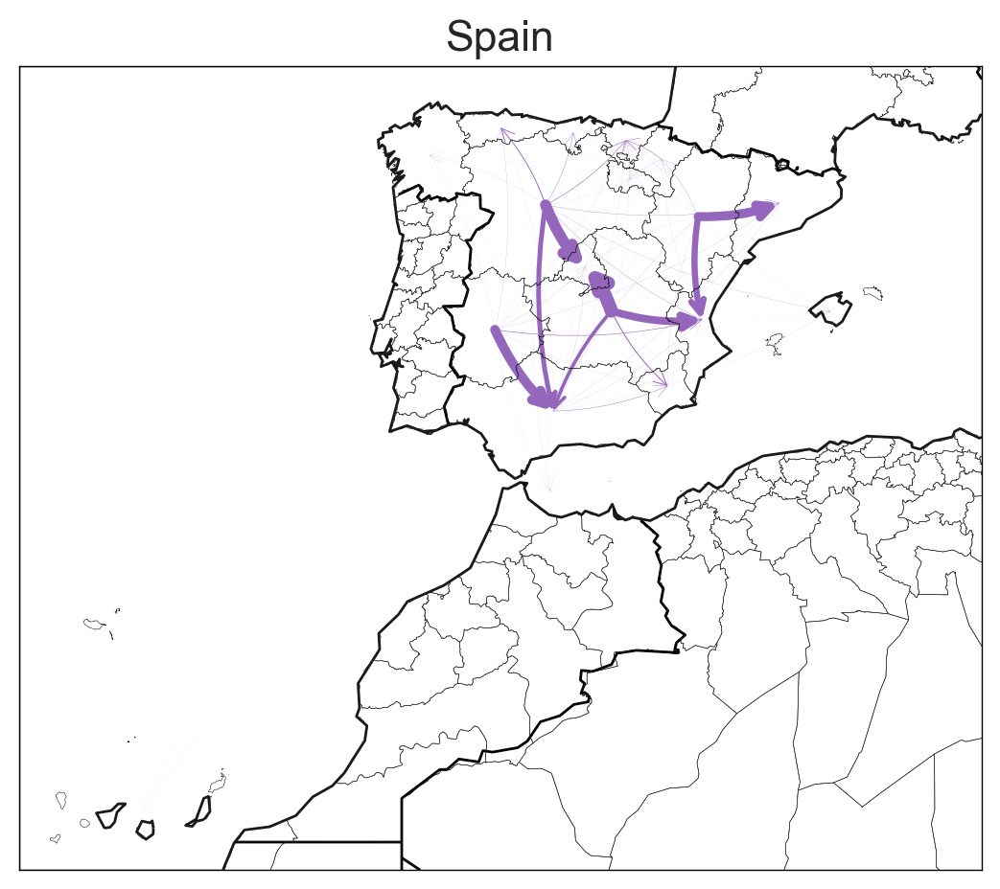

In [7]:
# Figure 1c: i) Domestic flows in Spain. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 2e5
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='ESP')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=-19,
            llcrnrlat=27,
            urcrnrlon=7,
            urcrnrlat=44.5,
            ) 

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='ESP']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='ESP']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='ESP']['ID']):
    pos[elem] = (mx[count], my[count])

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('Spain', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

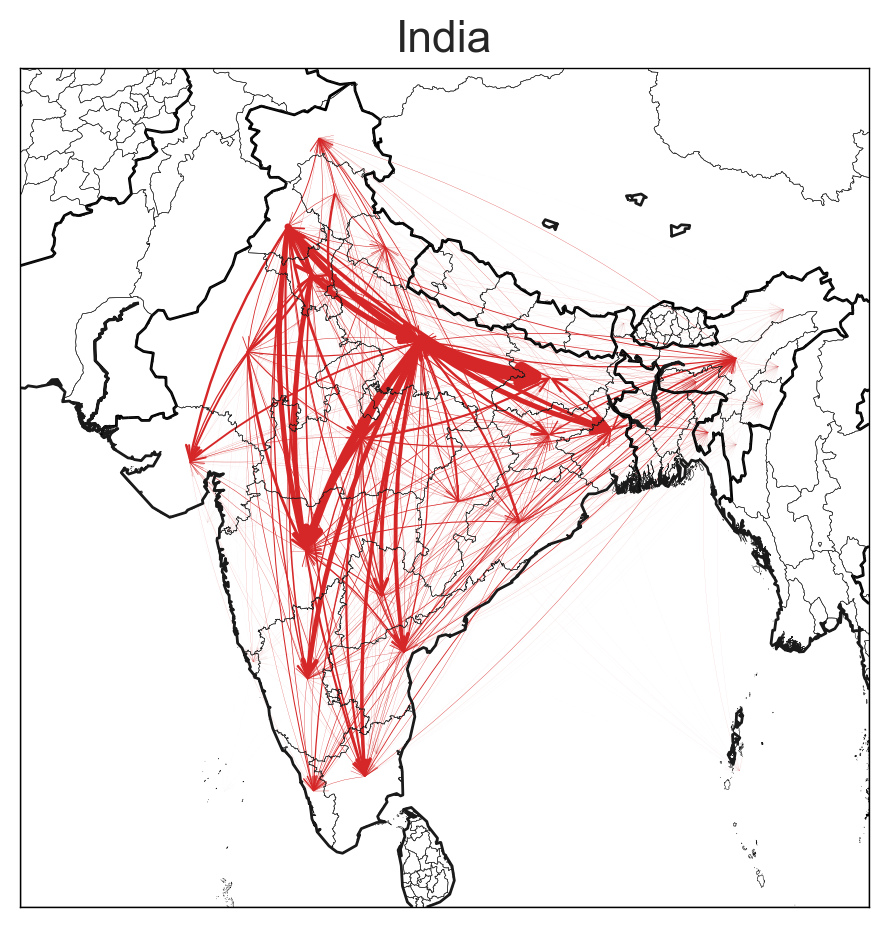

In [8]:
# Figure 1c: vi) Domestic flows in India. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 1e6
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='IND')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=65,
            llcrnrlat=6,
            urcrnrlon=98,
            urcrnrlat=36,
            )

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='IND']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='IND']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='IND']['ID']):
    pos[elem] = (mx[count], my[count]) 

# plt.figure(figsize = (8, 10))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('India', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

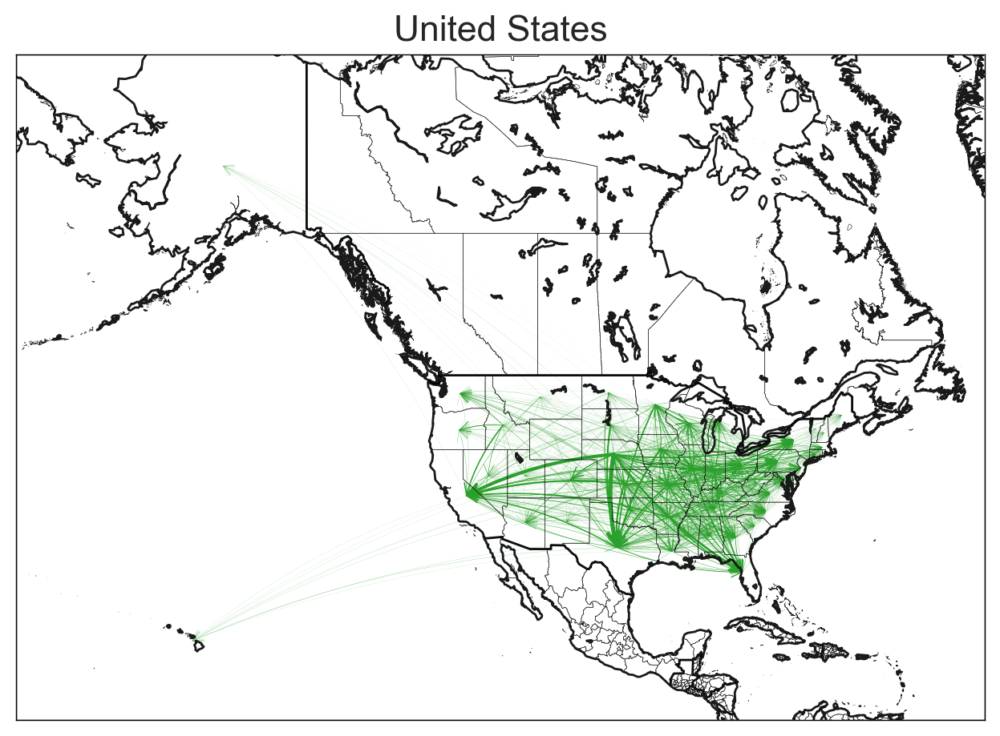

In [9]:
# Figure 1c: iv) Domestic flows in United States. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 2e6
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='USA')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=-180,
            llcrnrlat=10,
            urcrnrlon=-50,
            urcrnrlat=70,
            ) 

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='USA']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='USA']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='USA']['ID']):
    pos[elem] = (mx[count], my[count])

# plt.figure(figsize = (8, 10))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('United States', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

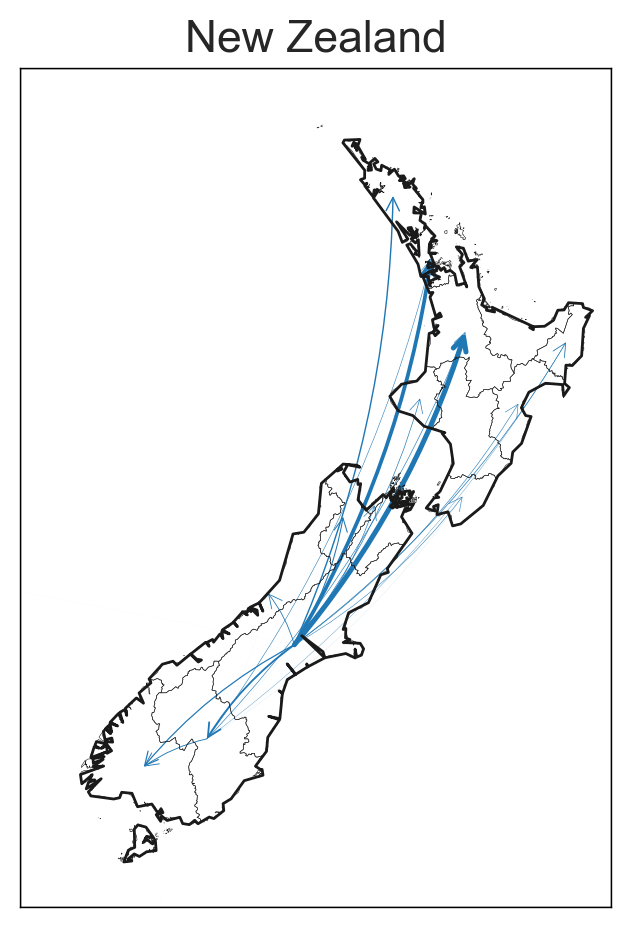

In [10]:
# Figure 1c: v) Domestic flows in New Zealand. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 5e4
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='NZL')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=165,
            llcrnrlat=-48,
            urcrnrlon=179,
            urcrnrlat=-33,
            ) 

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='NZL']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='NZL']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='NZL']['ID']):
    pos[elem] = (mx[count], my[count])

# plt.figure(figsize = (4, 6))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('New Zealand', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

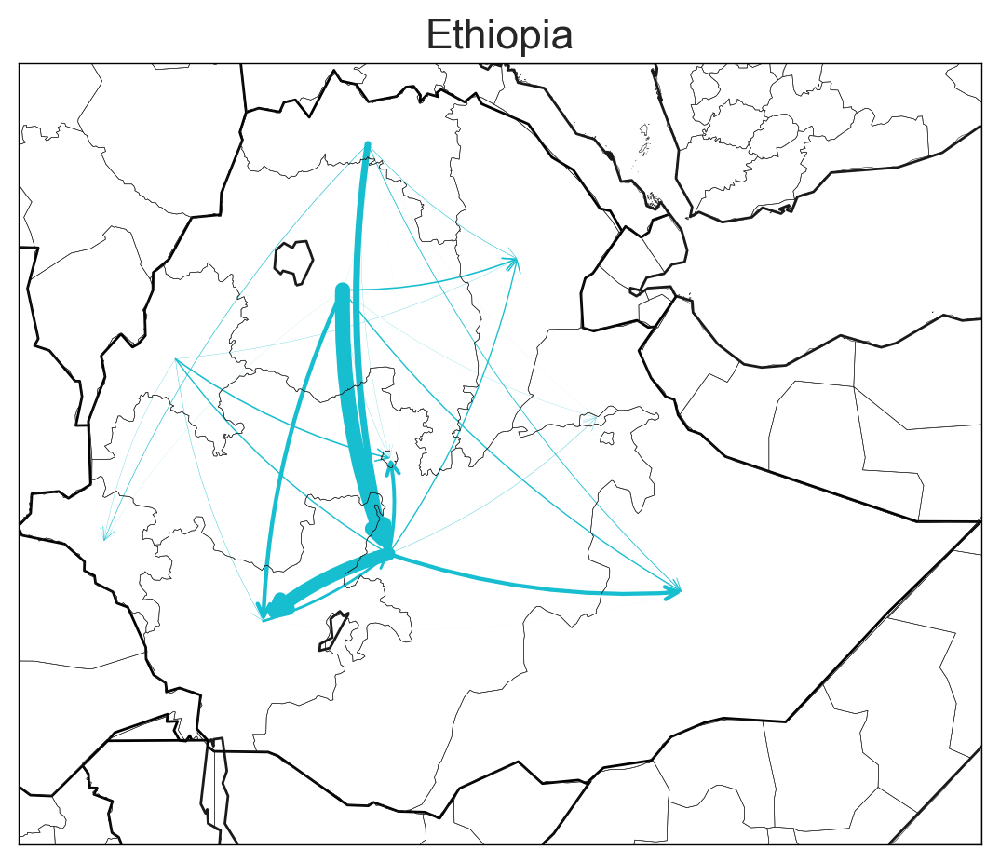

In [11]:
# Figure 1c: iii) Domestic flows in Ethiopia. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 2e5
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='ETH')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=33,
            llcrnrlat=3,
            urcrnrlon=48,
            urcrnrlat=15,
            ) 

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='ETH']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='ETH']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='ETH']['ID']):
    pos[elem] = (mx[count], my[count])

# plt.figure(figsize = (5, 6))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('Ethiopia', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

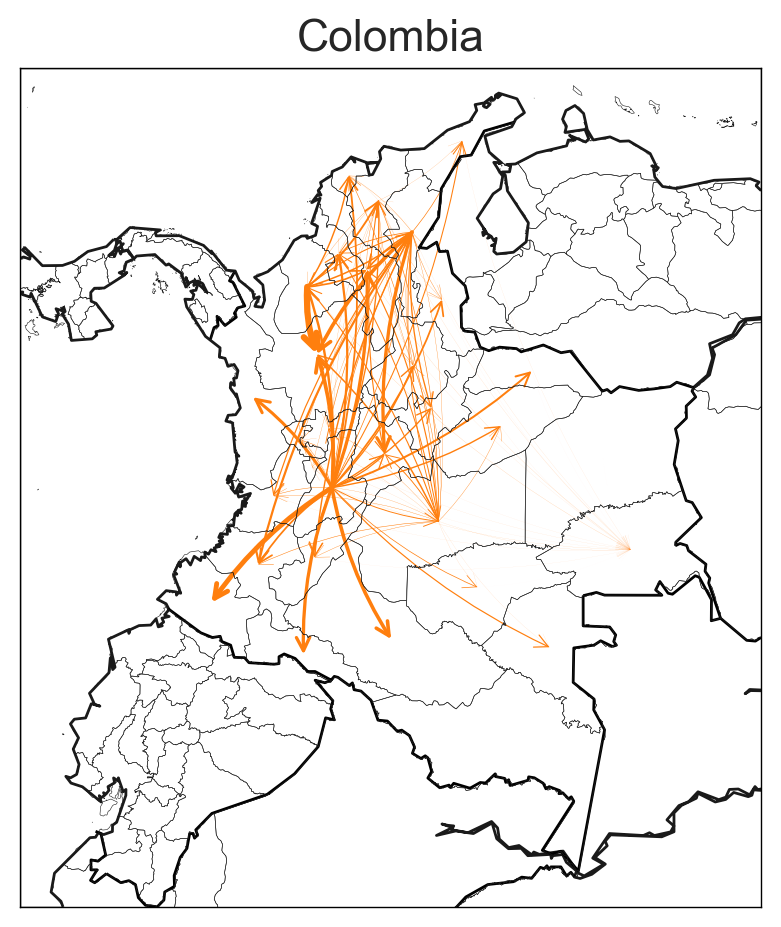

In [12]:
# Figure 1c: ii) Domestic flows in Colombia. Annual flows are presented, averaged over 2017-2021

df = subnational_bilateral_flows_fig1b_1c[subnational_bilateral_flows_fig1b_1c['from_iso3']==subnational_bilateral_flows_fig1b_1c['to_iso3']]
df = df[df['cereal_flow']>1]
df['cereal_flow'] = df['cereal_flow'] / 3e4
df = df.merge(national_IDs[['iso3', 'color']], how='left', left_on='from_iso3', right_on='iso3').drop('iso3', axis=1)

# predicted subnational flows
graph = nx.from_pandas_edgelist(df[(df['from_iso3']=='COL')], source='from_ID', target='to_ID',
                                edge_attr=['cereal_flow', 'color'], create_using=nx.MultiDiGraph())

weights = nx.get_edge_attributes(graph, 'cereal_flow').values()
colors = nx.get_edge_attributes(graph, 'color').values()

m = Basemap(resolution='l',
            projection='merc',
            llcrnrlon=-82,
            llcrnrlat=-5,
            urcrnrlon=-66,
            urcrnrlat=13,
            ) 

# admin positions
mx, my = m(subnational_IDs[subnational_IDs['iso3']=='COL']['longitude'].values, subnational_IDs[subnational_IDs['iso3']=='COL']['latitude'].values)
pos = {}
for count, elem in enumerate (subnational_IDs[subnational_IDs['iso3']=='COL']['ID']):
    pos[elem] = (mx[count], my[count])

# plt.figure(figsize = (5, 6))

m.drawmapboundary(color='black', 
                  linewidth=0.5, 
                  fill_color='white')
m.drawcoastlines(linewidth=1)
m.fillcontinents('white', 
                 lake_color='white')
m.drawcountries(linewidth=1, 
                linestyle='solid', 
                color='black', 
                # zorder=30
               )

m.shadedrelief(scale=0.2, alpha=0.3)

title = plt.title('Colombia', 
                  fontsize=16)

m.readshapefile('data/subnational_IDs.gpkg/subnational_IDs', 'subnational_IDs', default_encoding='iso-8859-15', linewidth=0.2)

h = nx.draw_networkx_edges(G=graph, pos=pos, width=list(weights), edge_color=list(colors),
                           node_shape='', node_size=0, alpha=1, connectionstyle="arc3,rad=0.1",
                           arrows=True, arrowsize=12, arrowstyle='->')

plt.tight_layout()
plt.show()

#### Table 1

In [13]:
# Largest cereal flows at national scales
df = national_bilateral_flows_fig1a.merge(national_IDs[['iso3', 'country']], left_on='from_iso3', right_on='iso3').drop('iso3', axis=1).rename(
    columns={'country': 'Exporting country'}).merge(national_IDs[['iso3', 'country']], left_on='to_iso3', right_on='iso3').drop('iso3', axis=1).rename(
    columns={'country': 'Importing country', 'cereal_flow': 'Cereal flow (million tonnes)'})
df['Cereal flow (million tonnes)'] = df['Cereal flow (million tonnes)']/1e6

print('Largest cereal flows at national scales')
df.sort_values('Cereal flow (million tonnes)', ascending=False).reset_index(drop=True).head(10)[['Exporting country', 'Importing country', 'Cereal flow (million tonnes)']]

Largest cereal flows at national scales


,Exporting country,Importing country,Cereal flow (million tonnes)
0,United States,Mexico,19.276595
1,United States,Japan,15.070551
2,United States,China,11.154393
3,Russia,Egypt,7.340391
4,Russia,Turkey,7.226723
5,Argentina,Vietnam,6.477986
6,Ukraine,China,6.470696
7,Argentina,Brazil,6.012018
8,United States,Colombia,5.422847
9,United States,South Korea,5.402979


In [14]:
# Largest cereal flows at subnational scales, international

df = subnational_bilateral_flows_fig1b_1c.merge(subnational_IDs[['ID', 'admin_name', 'country']], left_on='from_ID', right_on='ID').drop('ID', axis=1).rename(
    columns={'admin_name': 'Exporting admin', 'country': 'Exporting country'}).merge(subnational_IDs[['ID', 'admin_name', 'country']], left_on='to_ID', right_on='ID').drop(
    'ID', axis=1).rename(columns={'admin_name': 'Importing admin', 'country': 'Importing country', 'cereal_flow': 'Cereal flow (million tonnes)'})
df['Cereal flow (million tonnes)'] = df['Cereal flow (million tonnes)']/1e6

print('Largest cereal flows at subnational scales, international')
df[df['from_iso3']!=df['to_iso3']].sort_values('Cereal flow (million tonnes)', ascending=False).reset_index(
    drop=True).head(10)[['Exporting admin', 'Exporting country', 'Importing admin', 'Importing country', 'Cereal flow (million tonnes)']]

Largest cereal flows at subnational scales, international


,Exporting admin,Exporting country,Importing admin,Importing country,Cereal flow (million tonnes)
0,Texas,United States,Nuevo León,Mexico,1.643196
1,Bahia,Brazil,Taiwan,Taiwan,1.173387
2,Buenos Aires,Argentina,Lima Province,Peru,1.029667
3,Mendoza,Argentina,Región Metropolitana de Santiago,Chile,0.888088
4,Texas,United States,Coahuila,Mexico,0.877242
5,Rio Grande do Sul,Brazil,Cataluña,Spain,0.864547
6,Hauts-de-France,France,Vlaanderen,Belgium,0.809417
7,Buenos Aires,Argentina,Johor,Malaysia,0.781776
8,Buenos Aires,Argentina,Selangor,Malaysia,0.729654
9,California,United States,Baja California,Mexico,0.716285


In [15]:
# Largest cereal flows at subnational scales, domestic

print('Largest cereal flows at subnational scales, domestic')
df[df['from_iso3']==df['to_iso3']].sort_values('Cereal flow (million tonnes)', ascending=False).reset_index(
    drop=True).head(10)[['Exporting admin', 'Exporting country', 'Importing admin', 'Importing country', 'Cereal flow (million tonnes)']]

Largest cereal flows at subnational scales, domestic


,Exporting admin,Exporting country,Importing admin,Importing country,Cereal flow (million tonnes)
0,Uttar Pradesh,India,Bihar,India,5.147527
1,Nusa Tenggara Timur,Indonesia,Jawa Barat,Indonesia,4.574500
2,Nebraska,United States,Texas,United States,3.754229
3,Heilongjiang,China,Jilin,China,3.393950
4,Uttar Pradesh,India,Maharashtra,India,3.026685
5,Nebraska,United States,California,United States,2.916621
6,Heilongjiang,China,Liaoning,China,2.847681
7,Anhui,China,Guangdong,China,2.758692
8,Henan,China,Sichuan,China,2.722593
9,Anhui,China,Zhejiang,China,2.653220


#### Figure 2

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

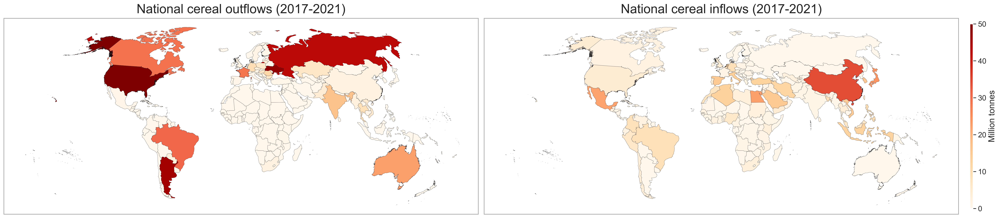

In [18]:
# Total cereal outflows and inflows at national scales

df = national_IDs.merge(fig2_national_flows, how='right')
df['inflows'] = df['inflows'] / 1e6
df['outflows'] = df['outflows'] / 1e6

df = df.to_crs('+proj=wintri')

fig, axs = plt.subplots(1, 2, figsize=(30,10), dpi=200)
i=0

for ax in axs.flat:
    # ax.set_axis_off()
    ax.set_xlim(-21626498.145314723, 21607846.84020165)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('white')
    ax.spines['bottom'].set_color('#A9A9A9')
    ax.spines['top'].set_color('#A9A9A9') 
    ax.spines['right'].set_color('#A9A9A9')
    ax.spines['left'].set_color('#A9A9A9')

    if i==0:
        col = 'outflows'
        title = "National cereal outflows (2017-2021)"
    else:
        col = 'inflows'
        title = "National cereal inflows (2017-2021)"
    p = df.plot(ax=ax, column=col, 
            legend=False, 
            vmin=0, vmax=50,
            cmap='OrRd', edgecolor="black", linewidth=0.2
           )
    ax.set_title(title, fontsize=24, y=1.01)
    i+=1
    
fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=60)
cbar.set_label(label="Million tonnes", size=16)
cbar.ax.tick_params(labelsize=14) 
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.0f'))

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

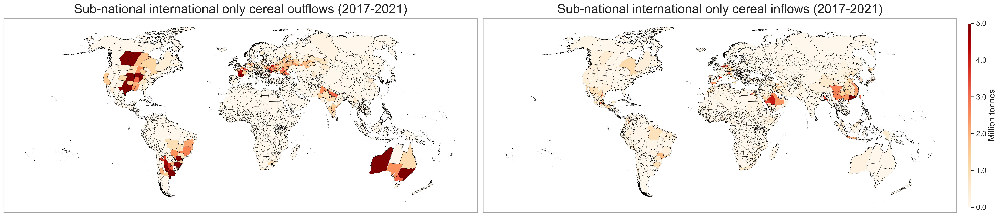

In [19]:
# Total cereal outflows and inflows at subnational scales, international 

df = subnational_IDs.merge(fig2_subnational_international_flows, how='right')
df['inflows'] = df['inflows'] / 1e6
df['outflows'] = df['outflows'] / 1e6
df = df.to_crs('+proj=wintri')

fig, axs = plt.subplots(1, 2, figsize=(30,10), dpi=200)
i=0

for ax in axs.flat:
    # ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('white')
    ax.spines['bottom'].set_color('#A9A9A9')
    ax.spines['top'].set_color('#A9A9A9') 
    ax.spines['right'].set_color('#A9A9A9')
    ax.spines['left'].set_color('#A9A9A9')

    if i==0:
        col = 'outflows'
        title = "Sub-national international only cereal outflows (2017-2021)"
    else:
        col = 'inflows'
        title = "Sub-national international only cereal inflows (2017-2021)"
    p = df.plot(ax=ax, column=col, 
            legend=False, 
            vmin=0, vmax=5,
            cmap='OrRd', edgecolor="black", linewidth=0.2
           )
    ax.set_title(title, fontsize=24, y=1.01)
    i+=1
    
fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=60)
cbar.set_label(label="Million tonnes", size=16)
cbar.ax.tick_params(labelsize=14)
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.1f'))

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

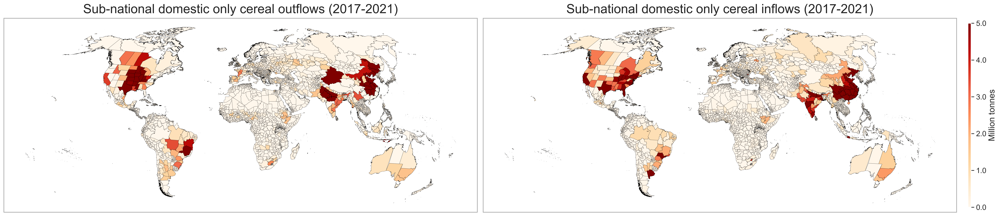

In [20]:
# Total cereal outflows and inflows at subnational scales, domestic

df = subnational_IDs.merge(fig2_subnational_domestic_flows, how='right')
df['inflows'] = df['inflows'] / 1e6
df['outflows'] = df['outflows'] / 1e6
df = df.to_crs('+proj=wintri')

fig, axs = plt.subplots(1, 2, figsize=(30,10), dpi=200)
i=0

for ax in axs.flat:
    # ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('white')
    ax.spines['bottom'].set_color('#A9A9A9')
    ax.spines['top'].set_color('#A9A9A9') 
    ax.spines['right'].set_color('#A9A9A9')
    ax.spines['left'].set_color('#A9A9A9')

    if i==0:
        col = 'outflows'
        title = "Sub-national domestic only cereal outflows (2017-2021)"
    else:
        col = 'inflows'
        title = "Sub-national domestic only cereal inflows (2017-2021)"
    p = df.plot(ax=ax, column=col, 
            legend=False, 
            vmin=0, vmax=5,
            cmap='OrRd', edgecolor="black", linewidth=0.2
           )
    ax.set_title(title, fontsize=24, y=1.01)
    i+=1
    
fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=60)
cbar.set_label(label="Million tonnes", size=16)
cbar.ax.tick_params(labelsize=14)
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.1f'))

#### Table 2

In [21]:
# Regions with largest outflows, national 
df = fig2_national_flows.merge(national_IDs[['iso3', 'country']]).rename(columns={
    'outflows': 'Cereal outflows (million tonnes)', 'inflows': 'Cereal inflows (million tonnes)'})
df['Cereal outflows (million tonnes)'] = df['Cereal outflows (million tonnes)']/1e6
df['Cereal inflows (million tonnes)'] = df['Cereal inflows (million tonnes)']/1e6

print('Largest regional cereal outflows, national')
df.sort_values('Cereal outflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['country', 'Cereal outflows (million tonnes)']]

Largest regional cereal outflows, national


,country,Cereal outflows (million tonnes)
0,United States,89.744006
1,Ukraine,47.501300
2,Argentina,45.689915
3,Russia,42.439944
4,Brazil,30.831113


In [22]:
# Regions with largest inflows, national 
print('Largest regional cereal inflows, national')
df.sort_values('Cereal inflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['country', 'Cereal inflows (million tonnes)']]

Largest regional cereal inflows, national


,country,Cereal inflows (million tonnes)
0,China,34.092555
1,Japan,24.002339
2,Egypt,22.355302
3,Mexico,21.971980
4,South Korea,15.560742


In [23]:
# Regions with largest outflows, subnational international

df = fig2_subnational_international_flows.merge(subnational_IDs[['ID', 'country', 'admin_name']]).rename(columns={
    'outflows': 'Cereal outflows (million tonnes)', 'inflows': 'Cereal inflows (million tonnes)'})
df['Cereal outflows (million tonnes)'] = df['Cereal outflows (million tonnes)']/1e6
df['Cereal inflows (million tonnes)'] = df['Cereal inflows (million tonnes)']/1e6

print('Largest regional cereal outflows, subnational international')
df.sort_values('Cereal outflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['admin_name', 'country', 'Cereal outflows (million tonnes)']]

Largest regional cereal outflows, subnational international


,admin_name,country,Cereal outflows (million tonnes)
0,Texas,United States,19.808960
1,Buenos Aires,Argentina,17.608257
2,Illinois,United States,14.876094
3,Rio Grande do Sul,Brazil,14.734868
4,Saskatchewan,Canada,13.750514


In [24]:
# Regions with largest inflows, subnational international
print('Largest regional cereal inflows, subnational international')
df.sort_values('Cereal inflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['admin_name', 'country', 'Cereal inflows (million tonnes)']]

Largest regional cereal inflows, subnational international


,admin_name,country,Cereal inflows (million tonnes)
0,Gyeonggi-do,South Korea,5.414785
1,Guangdong,China,5.155807
2,Vlaanderen,Belgium,4.730753
3,Cataluña,Spain,4.099895
4,Ar Riyad,Saudi Arabia,4.027144


In [25]:
# Regions with largest outflows, subnational domestic

df = fig2_subnational_domestic_flows.merge(subnational_IDs[['ID', 'country', 'admin_name']]).rename(columns={
    'outflows': 'Cereal outflows (million tonnes)', 'inflows': 'Cereal inflows (million tonnes)'})
df['Cereal outflows (million tonnes)'] = df['Cereal outflows (million tonnes)']/1e6
df['Cereal inflows (million tonnes)'] = df['Cereal inflows (million tonnes)']/1e6

print('Largest regional cereal outflows, subnational domestic')
df.sort_values('Cereal outflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['admin_name', 'country', 'Cereal outflows (million tonnes)']]

Largest regional cereal outflows, subnational domestic


,admin_name,country,Cereal outflows (million tonnes)
0,Nebraska,United States,24.753722
1,Shandong,China,23.633765
2,Uttar Pradesh,India,23.276528
3,Anhui,China,22.262354
4,Henan,China,20.630127


In [26]:
# Regions with largest inflows, subnational domestic
print('Largest regional cereal inflows, subnational domestic')
df.sort_values('Cereal inflows (million tonnes)', ascending=False).reset_index(drop=True).head()[['admin_name', 'country', 'Cereal inflows (million tonnes)']]

Largest regional cereal inflows, subnational domestic


,admin_name,country,Cereal inflows (million tonnes)
0,Guangdong,China,20.798262
1,Texas,United States,17.837164
2,Sichuan,China,17.490704
3,Florida,United States,13.839505
4,California,United States,13.771046


#### Figure 3

In [27]:
# domestic net exports of surplus regions in net importing countries
df_imp_sur_dom = fig3a
df_imp_sur_dom['net'] = df_imp_sur_dom['net']*-1
df_imp_sur_dom = subnational_IDs.merge(fig2_subnational_international_flows[['iso3', 'ID']], how='right').merge(df_imp_sur_dom, how='left')
df_imp_sur_dom = df_imp_sur_dom.to_crs('+proj=wintri')

# international net exports of surplus regions in net importing countries
df_imp_sur_int = fig3b
df_imp_sur_int['net'] = df_imp_sur_int['net']*-1
df_imp_sur_int = subnational_IDs.merge(fig2_subnational_international_flows[['iso3', 'ID']], how='right').merge(df_imp_sur_int, how='left')
df_imp_sur_int = df_imp_sur_int.to_crs('+proj=wintri')

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

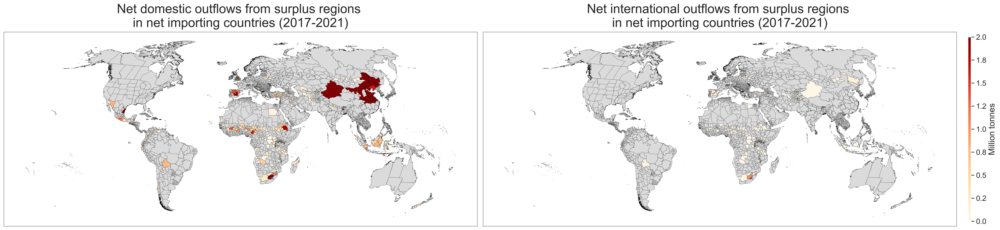

In [28]:
fig, axs = plt.subplots(1, 2, figsize=(30,10), dpi=200)
i=0

for ax in axs.flat:
    # ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('white')
    ax.spines['bottom'].set_color('#A9A9A9')
    ax.spines['top'].set_color('#A9A9A9') 
    ax.spines['right'].set_color('#A9A9A9')
    ax.spines['left'].set_color('#A9A9A9')

    if i==0:
        p = df_imp_sur_dom.plot(ax=ax, column='net', 
                                legend=False, 
                                vmin=0, vmax=2,
                                cmap='OrRd', edgecolor="black", linewidth=0.2,
                                missing_kwds= {'color': 'gainsboro'}
                               )
        title = "Net domestic outflows from surplus regions \nin net importing countries (2017-2021)"
    else:
        p = df_imp_sur_int.plot(ax=ax, column='net', 
                                legend=False, 
                                vmin=0, vmax=2,
                                cmap='OrRd', edgecolor="black", linewidth=0.2, 
                                missing_kwds= {'color': 'gainsboro'}
                               )
        title = "Net international outflows from surplus regions \nin net importing countries (2017-2021)"
    ax.set_title(title, fontsize=24, y=1.01)
    i+=1
    
fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=60)
cbar.set_label(label="Million tonnes", size=16)
cbar.ax.tick_params(labelsize=14)
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.1f'))

In [29]:
# domestic net imports of deficit regions in net exporting countries
df_exp_def_dom = fig3c
df_exp_def_dom = subnational_IDs.merge(fig2_subnational_international_flows[['iso3', 'ID']], how='right').merge(df_exp_def_dom, how='left')
df_exp_def_dom = df_exp_def_dom.to_crs('+proj=wintri')

# international net exports of surplus regions in net importing countries
df_exp_def_int = fig3d
df_exp_def_int = subnational_IDs.merge(fig2_subnational_international_flows[['iso3', 'ID']], how='right').merge(df_exp_def_int, how='left')
df_exp_def_int = df_exp_def_int.to_crs('+proj=wintri')

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

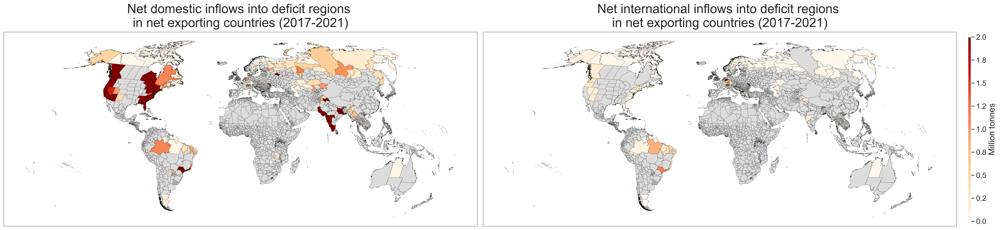

In [30]:
fig, axs = plt.subplots(1, 2, figsize=(30,10), dpi=200)
i=0

for ax in axs.flat:
    # ax.set_axis_off()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    ax.set_facecolor('white')
    ax.spines['bottom'].set_color('#A9A9A9')
    ax.spines['top'].set_color('#A9A9A9') 
    ax.spines['right'].set_color('#A9A9A9')
    ax.spines['left'].set_color('#A9A9A9')

    if i==0:
        p = df_exp_def_dom.plot(ax=ax, column='net', 
                                legend=False, 
                                vmin=0, vmax=2,
                                cmap='OrRd', edgecolor="black", linewidth=0.2,
                                missing_kwds= {'color': 'gainsboro'}
                               )
        title = "Net domestic inflows into deficit regions \nin net exporting countries (2017-2021)"
    else:
        p = df_exp_def_int.plot(ax=ax, column='net', 
                                legend=False, 
                                vmin=0, vmax=2,
                                cmap='OrRd', edgecolor="black", linewidth=0.2, 
                                missing_kwds= {'color': 'gainsboro'}
                               )
        title = "Net international inflows into deficit regions \nin net exporting countries (2017-2021)"
    ax.set_title(title, fontsize=24, y=1.01)
    i+=1
    
fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=60)
cbar.set_label(label="Million tonnes", size=16)
cbar.ax.tick_params(labelsize=14)
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.1f'))

#### Figure 4

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/ipykernel_launcher.py:111: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


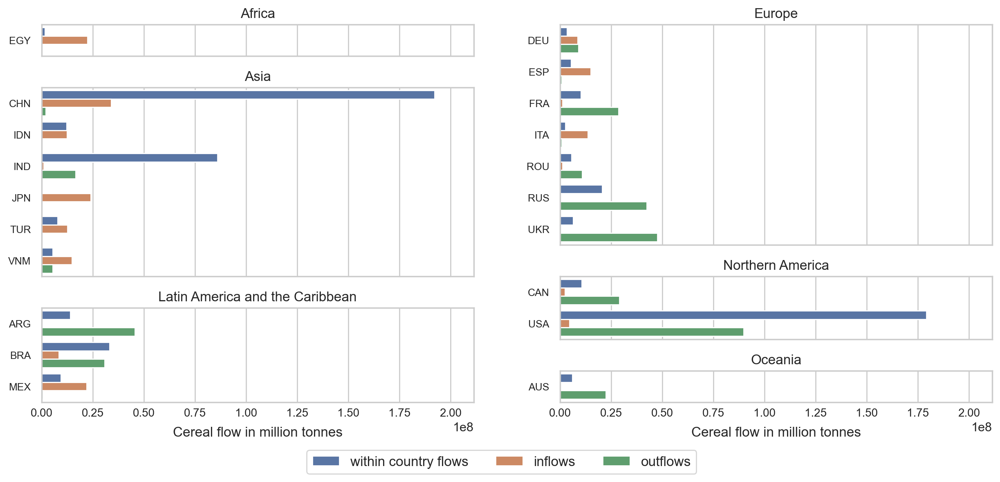

In [33]:
# Figure 4: A comparison of inflows, outflows, and within country flows for a select 20 countries (2017-2021)

countries = fig4.groupby('iso3').sum()[[
    'value']].reset_index().sort_values('value').tail(20)['iso3'].unique()
df = fig4[fig4['iso3'].isin(countries)]

sns.set_style("whitegrid")

# two columns
first   = ['Africa','Asia','Latin America and the Caribbean']
second  = ['Europe','Northern America','Oceania']
hue_order = ['within country flows','inflows','outflows']

# row-height ratios for each column
ratios1 = df.groupby('Region Name')['iso3'] \
          .nunique().reindex(first).values
ratios2 = df.groupby('Region Name')['iso3'] \
          .nunique().reindex(second).values

# global x-limit
xmax = df['value'].max() * 1.1

fig = plt.figure(figsize=(15, 6))
outer = gridspec.GridSpec(1, 2, width_ratios=[1,1], wspace=0.2)

# left column (3 rows)
gs_left = gridspec.GridSpecFromSubplotSpec(
    nrows=len(first), ncols=1,
    subplot_spec=outer[0],
    height_ratios=ratios1,
    hspace=0.3
)

ax_master = None
for i, region in enumerate(first):
    if i == 0:
        ax = fig.add_subplot(gs_left[i])
        ax_master = ax
    else:
        ax = fig.add_subplot(gs_left[i], sharex=ax_master)
    df_sub = df[df['Region Name']==region]
    sns.barplot(
        data=df_sub, x='value', y='iso3', hue='variable',
        # width=0.6, 
        hue_order=hue_order, ax=ax
    )

    # remove that subplot’s legend if one appeared
    if ax.get_legend():  
        ax.get_legend().remove()
    
    ax.set_title(region, loc='center', fontsize=12)
    ax.set_ylabel('') 
    ax.tick_params(axis='y', labelsize=9)

    # only bottom subplot in this column gets x-ticks + label
    if i < len(first)-1:
        ax.set_xlabel('') 
        ax.tick_params(axis='x', labelbottom=False)
    else:
        ax.set_xlabel('Cereal flow in million tonnes', fontsize=12, labelpad=7)
        ax.tick_params(axis='x', labelsize=10, pad=-1)

# right column (3 rows) 
gs_right = gridspec.GridSpecFromSubplotSpec(
    nrows=len(second), ncols=1,
    subplot_spec=outer[1],
    height_ratios=ratios2,
    hspace=0.3
)
for i, region in enumerate(second):
    ax = fig.add_subplot(gs_right[i], sharex=ax_master)
    df_sub = df[df['Region Name']==region]
    sns.barplot(
        data=df_sub, x='value', y='iso3', hue='variable',
        # width=0.6, 
        hue_order=hue_order, ax=ax
    )

    # remove that subplot’s legend if one appeared
    if ax.get_legend():  
        ax.get_legend().remove()
    
    ax.set_title(region, loc='center', fontsize=12)
    ax.set_ylabel('')
    ax.tick_params(axis='y', labelsize=9)

    # only bottom subplot in this column gets x-ticks + label
    if i < len(second)-1:
        ax.set_xlabel('') 
        ax.tick_params(axis='x', labelbottom=False)
    else:
        ax.set_xlabel('Cereal flow in million tonnes', fontsize=12, labelpad=7)
        ax.tick_params(axis='x', labelsize=10, pad=-1)

# same limits for all x-axes 
ax_master.set_xlim(0, xmax)

# single global legend
# grab handles from the last axis you drew
handles, labels = ax_master.get_legend_handles_labels()
fig.legend(
    handles, labels,
    loc='lower center',
    ncol=len(hue_order),
    bbox_to_anchor=(0.5, -0.05),
    fontsize=12,
    title=None
)

plt.tight_layout()

#### Figure 5

/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array interface is deprecated and will no longer work in Shapely 2.0. Convert the '.coords' to a numpy array instead.
  for t in polygon])
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/geopandas/plotting.py:49: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for poly in geom:
/Users/shruti/anaconda3/envs/ct_map/lib/python3.7/site-packages/descartes/patch.py:65: ShapelyDeprecationWarning: The array inter

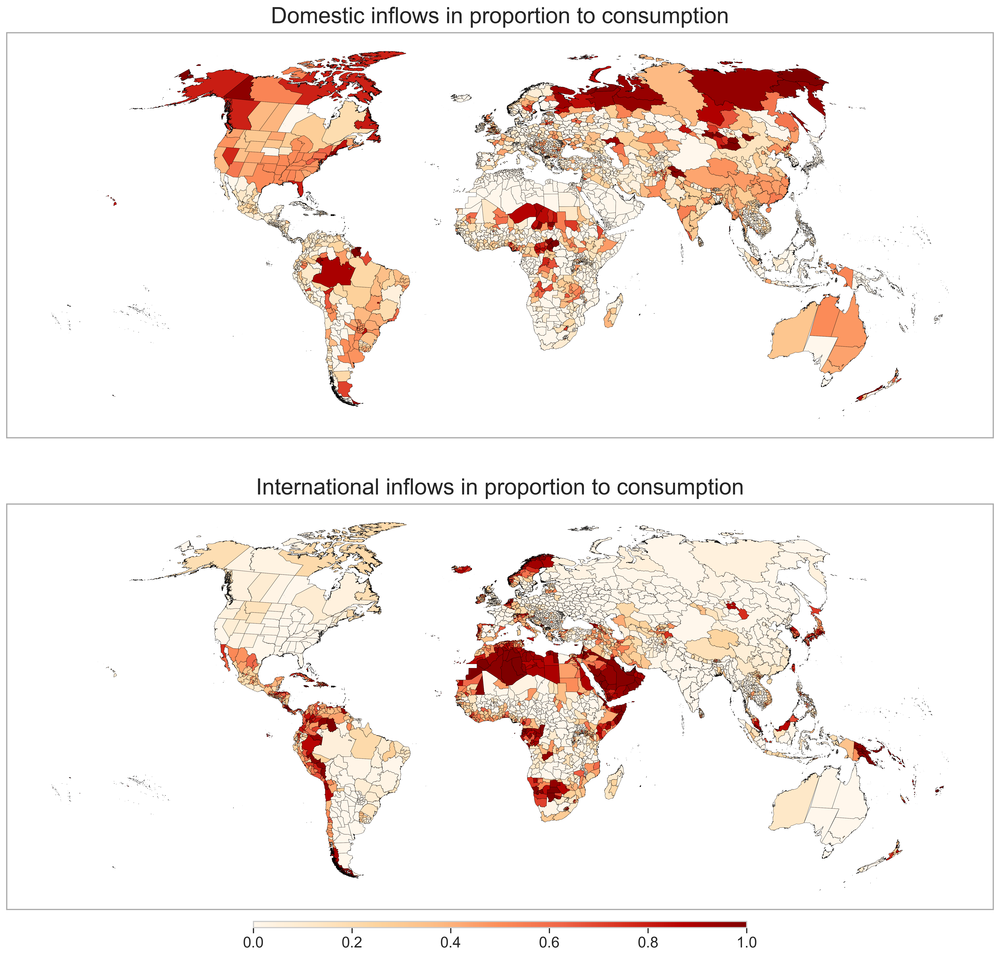

In [34]:
# Figure 5: Regional inflows in proportion to consumption (2017-2021)

fig, axs = plt.subplots(2, 1, figsize=(15,18), dpi=180)

df = subnational_IDs.merge(fig5, how='right')
df = df.to_crs('+proj=wintri')

# subplot1
ax = axs[0]
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
ax.set_facecolor('white')
ax.spines['bottom'].set_color('#A9A9A9')
ax.spines['top'].set_color('#A9A9A9') 
ax.spines['right'].set_color('#A9A9A9')
ax.spines['left'].set_color('#A9A9A9')

p1 = df.plot(ax=ax, column='proportion_domestic_inflows', legend=False, vmin=0, vmax=1,
            cmap='OrRd', edgecolor="black", linewidth=0.2)
ax.set_title("Domestic inflows in proportion to consumption", fontsize=24, y=1.01)

# subplot 2
ax = axs[1]
ax.get_xaxis().set_visible(False)
ax.get_yaxis().set_visible(False)
ax.set_facecolor('white')
ax.spines['bottom'].set_color('#A9A9A9')
ax.spines['top'].set_color('#A9A9A9') 
ax.spines['right'].set_color('#A9A9A9')
ax.spines['left'].set_color('#A9A9A9')

p2 = df.plot(ax=ax, column='proportion_international_inflows', legend=False, vmin=0, vmax=1,
            cmap='OrRd', edgecolor="black", linewidth=0.2)
ax.set_title("International inflows in proportion to consumption", fontsize=24, y=1.01)

fig.tight_layout()

im = plt.gca().get_children()[0]
cbar = fig.colorbar(im, ax=axs.ravel().tolist(), shrink=0.5, pad=0.01, aspect=80, orientation='horizontal')
cbar.ax.tick_params(labelsize=16)
cbar.ax.yaxis.set_major_formatter(tkr.FormatStrFormatter('%.1f'))